<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/MMU_logo.png" width=150 align="right"/>
<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/python_logo.png" width="150" align="right"/>


# Modelling a Zombie Outbreak

---
<table align="center">
    <tr>
        <td align="left">
            <span style="font-weight:normal" align="left">
                <b>Dr Jon Shiach</b> <br><br>
                Senior Lecturer <br>
                Department of Computing and Mathematics<br>
                Manchester Metropolitan University<br> 
                Email: <a href="mailto:j.shiach@mmu.ac.uk">j.shiach@mmu.ac.uk</a>
            </span>
        </td>
        <td>
            <img width="100" height="100" src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/jon_shiach.jpeg">
        </td>
    </tr>
</table>

---

[Click here to download the Jupyter notebook](https://github.com/drjonshiach/Agent-Based-Modelling/archive/refs/heads/main.zip)



## Introduction

[**Mathematical modelling**](https://en.wikipedia.org/wiki/Mathematical_model) is a description of a situation or scenario that is described using mathematical concepts. These models can be very useful as they can allow us to identify possible solutions without first implementing them in the real world. For example, NASA used mathematical models to predict the forces experienced by astronauts to see whether they could survive a trip into space.

Here we are going to look at a type of mathematical model called an [**Agent Based Model**](https://en.wikipedia.org/wiki/Agent-based_model) which can be used to model the behaviour of a group of animals or people. Agent based models consist of a number of autonomous agents which are given a set of rules that govern the agents behaviour in the system. For example, an agent may represent a predator which is given a rule that it will chase the nearest prey.

This Jupyter notebook will introduce you to agent based models and how can we write [**Python**](https://www.python.org/) programs to model complex behaviour. The programs are written for you but you can make changes to the parameters or even add to the programs if you wish.

### Contents

1. [Agent based modelling](#Agent-based-modelling)
1. [Modelling flocking fehaviour](#Modelling-flocking-behaviour)
1. [Modelling a zombie outbreak](#Modelling-a-zombie-outbreak)
1. [Modelling the spread of Covid](#Modelling-the-spread-of-Covid)

### Jupyter notebooks

Jupyter notebooks are documents that combine text and Python code which allow readable documents such as this one to be created that contain executable code used to perform calculations. To run code in a notebook simply click on the code and then on the run button, or alternatively, press the **ctrl + enter** keys at the same time. Since we will be using commands to perform calculations and produce our models we need to import some commands to help us to do this. Run the code below to import the commands.

In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import animation, patches, collections
from IPython.display import HTML
from ipywidgets import IntProgress
matplotlib.rcParams['animation.embed_limit'] = 2**128

Now we can perform some calculations. The Python code below calculates the length of the hypotenuse of a right angled triangle using the lengths of the two smallest sides and prints the result. Note how the equation $c = \sqrt{a^2 + b^2}$ is entered in a similar way to how we write it on a piece of paper. Can you calculate the length of the hypotenuse when $a = 5$ and $b = 12$

In [2]:
a = 3
b = 4
c = np.sqrt(a ** 2 + b ** 2)
print(c)

5.0


---
## Agent based modelling

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/field.svg" align=right width=350>

An agent based model uses individual autonomous **agents** to which we can give **rules** that will govern their movement and behaviour. In the models we will use here the agents exist within a finite rectangular region of a given width and height. Each agent is described by its **position** within the region and **velocity**. The position is given by a set of co-ordinates $(x,y)$ where $x$ and $y$ are the horizontal and vertical distances from the bottom left-hand corner of the region. The velocity, which governs the direction the agent moves in, is given by the **velocity vector** (a vector is an arrow with a direction and length) which is represented by $(v_x,v_y)$ where $v_x$ and $v_y$ are the horizontal and vertical speeds of the agent. We can calculate the speed of an agent from the velocity vector using Pythagoras' theorem

$$\textsf{speed} = \sqrt{ v_x ^2 + v_y ^ 2}.$$

This is known as the **norm** of the velocity vector and is equivalent to the length of the vector. 

To program an agent based model in Python we start by defining an agent object which contains all of the commands that are applied to an agent. The code below defines an agent and gives it a random position and velocity as well as some other attributes which are explained by the comments following the `#` symbol. The function `AgentList()` generates a list containing all of the agents in the model.

In [3]:
class agent:
    def __init__(self):
        self.x = width * np.random.rand()   # x co-ordinate
        self.y = height * np.random.rand()  # y co-ordinate
        self.vx = np.random.uniform(-1, 1)  # velocity in the x direction
        self.vy = np.random.uniform(-1, 1)  # velocity in the y direction
        self.status = "boid"                # status of the agent
        self.colour = "blue"                # colour of the agent (when plotted)
        self.minspeed = 5                   # minimum speed of the agent
        self.maxspeed = 10.                 # maximum speed of the agent
        self.neighbours = []                # list of neighbouring agents
        self.move = True                    # does the agent move?
       
    def AgentList():
        return [agent() for _ in range(nagents)]

### Movement

To model the movement of agents we divide the time which we are simulating into lots of individual **time steps**. If we know the position and velocity of an agent at one time step we can calculate the position at the next time step using

$$\textsf{new position} = \textsf{current position} + \textsf{velocity vector} \times \textsf{time step}.$$

This is shown in the diagram below where $\mathbf{p}_1$ is the current position of the agent and $\mathbf{p}_2$ and $\mathbf{p}_3$ are the positions in the next two time steps.

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/movement.svg" align=center width=300>

In the diagram above we see that the velocity vector does not change so this agent will continue to move along that same path forever. The velocity vector will change if there is some external force applied to the agent, for example, an agent may be attracted towards a particular target. The change in the velocity is known as **acceleration** which will be determined by any rules that we impose on our agents. 

In order to ensure that our agents do not exceed the maximum speed we have chosen for the agent, if the speed calculated using the norm of the velocity vector is greater than the maximum speed then we scale the velocity vector using

$$\textsf{velocity vector} = \textsf{velocity vector} \times \frac{\textsf{maximum speed}}{\textsf{speed}}.$$

We also do similar for ensuring the agent doesn't travel slower than its minimum speed.

The code below defines a function called `MoveAgent()` which calculates the position of the agent after one time step. The velocities in the $x$ and $y$ directions are scaled to ensure that the speed of the agent remains within the minimum and maximum speeds for the agent. The velocities are then multiplied by the time step and added to the agent position, `self.x` and `self.y`, to give the new position. 

In [4]:
class agent(agent): 
    def MoveAgent(self):
        if self.move:
            speed = np.sqrt(self.vx ** 2 + self.vy ** 2)
            if speed < self.minspeed:
                self.vx *= self.minspeed / speed
                self.vy *= self.minspeed / speed
            if speed > self.maxspeed:
                self.vx *= self.maxspeed / speed
                self.vy *= self.maxspeed / speed
            self.x += self.vx * time_step
            self.y += self.vy * time_step

### Steering

In an agent based model we have a set of rules that we apply to the agents. The **steering rules** that affect the movement of an agent will each generate a steering vector that are added together to give an **acceleration vector**

$$\textsf{acceleration vector} = \textsf{steering vector 1} + \textsf{steering vector 2} + \textsf{steering vector 3}$$

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/steering1.svg" align="center" />

An example of a rule imposed on an agent may be that it will travel towards a particular target as shown in the diagram below. The steering vector pointing in the direction of the target is calculated using 

$$\textsf{steering vector} = \textsf{target} - \textsf{position}.$$

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/steering2.svg" align="center" />

Since we may be combining several steering rules we may wish to prioritise some over the others. We can do this by multiplying the steering vector by a **steering factor** which is a number that we choose the value of in order to replicate the behaviour we want..

$$\textsf{acceleration vector} = \textsf{steering vector} \times \textsf{steering factor}.$$

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/steering3.svg" align="center" />

The diagram below shows how an agent will move towards a target over several time steps. Note that since the acceleration vector is limited by the steering factor the agents does immediately turn in the direction of the target, rather it gradually turns over a number of time steps. 

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/steering4.svg" width=350>

### Keeping the agents within the region

We must ensure that an agent does not pass through the edges of the region and escape. This is shown in the diagram below where the agent is approaching the bottom edge and if no external for is applied it would pass through the edge and out of the region.

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/edges.svg" align=center width=400>

To ensure agents remain in the region we apply a steering force if an agent gets too close to an edge which forces it to move away from the edge. A buffer zone is defined that contains the region within some distance of the edge, if an agent is in the buffer zone then a steering force is applied calculated using

\begin{align*}
    \textsf{steering vector} &= \frac{\textsf{direction vector}}{\textsf{distance from edge}^\textsf{2}},
\end{align*}

where the direction vector is a vector that points towards the interior of the region. By dividing the direction vector by the square of the distance from the edge the steering force is gentle when the agent is further away from the edge but progressively stronger as the distance from the decreases. This means that the agent will gradually turn away from the edge.

The code below defines the function `AvoidEdges()` which applies this rule for all four edges of the region defined the by the minimum and maximum $x$ and $y$ co-ordinates and a buffer zone defined by the area within a distance of 5 from an edge. 

In [5]:
class agent(agent):
    def AvoidEdges(self):
        buffer = 5
        if self.x < buffer:
            self.vx += 1 / self.x ** 2
        if self.x > width - buffer:
            self.vx -= 1 / (width - self.x) ** 2
        if self.y < buffer:
            self.vy += 1 / self.y ** 2
        if self.y > height - buffer:
            self.vy -= 1 / (height - self.y) ** 2

### Neighbouring agents

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/neighbourhood.svg" align=right width=300>

We want our agents to react to other agents which are the vicinity, for example, if we have an agent that represents a predator it will want to chase after any prey agent and a prey agent will want to flee away from a predator. In order to do this we need to determine which of the other agents can be detected by our agent. The simplest way to do this is to define a **detection zone** that is a circle surround our agent and all other agents that are within this circle are considered to have been detected by our agent. This could represent a predator using their senses of vision and smell to hunt for their prey. Agents that are within the detection zone are known as **neighbouring agents** because that are the agents that are nearest to our agent.

The code below defines the function `Neighbours()` which loops through all of the other agents in the model and calculates the squared distance to a current agent. If this distance is less than the square of the detection radius then it is added to a list of neighbours. The reason why the square of the distance is used is to avoid having to calculate a square root which is slower for a computer to calculate. 

In [6]:
class agent(agent):
    def Neighbours(self, agentlist):
        self.neighbours = []
        for neighbour in agentlist: 
            if id(self) == id(neighbour):
                continue
            dx = neighbour.x - self.x
            dy = neighbour.y - self.y
            if abs(dx) < detection_radius and abs(dy) < detection_radius:
                squared_distance = dx ** 2 + dy ** 2
                if squared_distance < detection_radius ** 2:
                    self.neighbours.append(neighbour)

--- 
## Modelling flocking behaviour

The first model we are going to look at is the modelling of flocking behaviour that can be seen in a group of birds flying together and in shoals of fish. Each individual animal in the group reacts to the other animals that surround it and adjusts its movement accordingly. The model [**Boids**](https://en.wikipedia.org/wiki/Boids) which was developed by Craig Reynolds uses three simple rules that are applied to the agents in the model to simulate flocking behaviour, these rules are:

- **Alignment**: an agent will steer in the direction of the average velocity vector for the other agents in the neighbourhood.
- **Cohesion**: an agent will steer towards the average position of the other agents in the neighbourhood.
- **Separation**: an agent will steer away from any agent that is too close to the agent.

The acceleration forces for all three of these rules is calculated and added to the acceleration vector for an agent.


### Alignment

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/alignment.svg" align=right width=250>

The alignment rule states that an agent will align itself to the average velocity vector of its neighbouring agents. The average velocity is calculated using

$$\textsf{average velocity} = \frac{\displaystyle\sum \textsf{velocity of neighbour}}{\textsf{number of neighbours}}.$$

The symbol $\sum$ is the Greek character *sigma* which is equivalent to the Latin character *s* and is used to denote the sum of a group of numbers. The equation above says that we add up all of the velocity vectors of the neighbouring agents and divide by the number of neighbours to get the average velocity. The steering vector for aligning to the neighbouring agents is then calculated by subtracting the agent velocity from the average velocity of the neighbourng agents and multiplying by the alignment factor

\begin{align*}
    \textsf{alignment vector} &= (\textsf{average velocity} - \textsf{agent velocity}) \times \textsf{alignment factor}.
\end{align*}
 
The code below defines the function `Alignment()` applies the alignment rule to the current agent.

In [7]:
class agent(agent): 
    def Alignment(self):
        n = average_vx = average_vy = 0
        for neighbour in self.neighbours:
            average_vx += neighbour.vx
            average_vy += neighbour.vy
            n += 1
        if n > 0:
            self.vx += (average_vx / n - self.vx) * alignment_factor
            self.vy += (average_vy / n - self.vy) * alignment_factor

### Cohesion

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/cohesion.svg" align=right width=300>

The cohesion rule states that an agent will steer towards the average position of it's neighbouring agents. The average position is calculated using

$$\textsf{average position of neighbours} = \frac{\displaystyle\sum \textsf{position of neighbour}}{\textsf{number of neighbours}}.$$

The steering vector is then calculated by subtracting the agent position from the average position of the neigbouring agents and multiplying by the cohesion factor.

\begin{align*}
    \textsf{cohesion vector} &= (\textsf{average position of neighbours} - \textsf{agent position}) \times \textsf{cohesion factor}.
\end{align*}

The code below defines the function `Cohesion()` applied the cohesion rule to the current agent.

In [8]:
class agent(agent):
    def Cohesion(self):
        n = average_x = average_y = 0
        for neighbour in self.neighbours:
            average_x += neighbour.x
            average_y += neighbour.y
            n += 1
        if n > 0:
            self.vx += (average_x / n - self.x) * cohesion_factor
            self.vy += (average_y / n - self.y) * cohesion_factor

### Separation

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/separation.svg" align=right width=250>

The separation rule states that an agent will steer away from agents that are within some small distance of it. For those neighbouring agents that are too close we calculate the steering vector using

\begin{align*}
    \textsf{separation vector} &= \sum \dfrac{\textsf{position of agent} - \textsf{position of neighbour}}{\textsf{squared distance to neighbour}} \times \textsf{separation factor}.
\end{align*}

By dividing the vector that points away from the neighbouring agent by the squared distance we scale the separation vector so that the closer a neighbour is, the stronger the seperation force from that neighbour. 

The code below defines a function called `Separation()` applies the separation rule for the current agent.

In [9]:
 class agent(agent):     
    def Separation(self):
        for neighbour in self.neighbours:
            squared_distance = (self.x - neighbour.x) ** 2 + (self.y - neighbour.y) ** 2
            if squared_distance < separation_radius ** 2:
                self.vx += (self.x - neighbour.x) / squared_distance * separation_factor
                self.vy += (self.y - neighbour.y) / squared_distance * separation_factor

### Applying the agent rules

The code below defines the function `Rules()` which combines the `AvoidEdges()`, `Alignment()`, `Cohesion()`, and `Separation()` rules for the Boids model defined above.

In [10]:
class agent(agent):
    def Rules(self):
        self.AvoidEdges()
        self.Alignment()
        self.Cohesion()
        self.Separation()

### Keeping track of the agents over time

We want to keep track of the changes in the agents through time so we can see what is happening in the model. To do this we can define arrays (think of these as tables of values) which will store the co-ordinates, velocities, colours, agent types and the number of agents of each type for each time step of the simulation. The function `Update()` updates these arrays at each time step and the function `PlotPopulation()` allows us to plot the populations of each agent type over time when the simulation has finished (this is not used in the current model but will be used in subsequent models).

In [11]:
class agent(agent):
    class data():
        def __init__(self,agentlist):
            self.x = np.array([agent.x for agent in agentlist])
            self.y = np.array([agent.y for agent in agentlist])
            self.vx = np.array([agent.vx for agent in agentlist])
            self.vy = np.array([agent.vy for agent in agentlist])
            self.colour = np.array([agent.colour for agent in agentlist])
            
        def InitialisePopulation(self, agentlist):
            self.agenttypes = ['boid']
            self.agentcolours = ['blue']
            self.population = np.array([[nagents]])

        def Update(self, agentlist):
            self.x = np.vstack((self.x, np.array([agent.x for agent in agentlist])))
            self.y = np.vstack((self.y, np.array([agent.y for agent in agentlist])))
            self.vx = np.vstack((self.vx, np.array([agent.vx for agent in agentlist])))
            self.vy = np.vstack((self.vy, np.array([agent.vy for agent in agentlist])))
            self.colour = np.vstack((self.colour, np.array([agent.colour for agent in agentlist])))
            ncols = self.population.shape[1]
            self.population = np.vstack((self.population, np.zeros(ncols)))
            for agent in agentlist:
                for i in range(ncols):
                    if agent.status == self.agenttypes[i]:
                        self.population[-1,i] += 1

        def PlotPopulation(self, title=""):
            t = np.arange(self.population.shape[0]) * time_step
            fig, ax = plt.subplots(figsize=(10,6))
            for i in range(self.population.shape[1]):
                plt.plot(t, self.population[:,i], self.agentcolours[i], label=self.agenttypes[i])
            ax.set_ylim([0, np.sum(self.population[0,:])])
            plt.title(title)
            plt.xlabel("time")
            plt.ylabel("population")
            plt.legend()
            plt.show()

### Animating the agents

The function `Animation()` defined below plots each agent using an isosceles triangle that points in the direction of the velocity vector. Plots are generated for each time step and combined to produce an animation that can be played in the Jupyter notebook.

In [12]:
class agent(agent):
    class data(agent.data):
        def Animation(self):

            # Setup plot
            fig, ax = plt.subplots(figsize=(6 * width / height, 6))
            ax.set_xlim(-0.1, width+0.1)
            ax.set_ylim(-0.1, height+0.1)
            ax.axis("off")
            patches = [plt.Polygon(np.zeros((3,2))) for _ in range(nagents)]
            collection = collections.PatchCollection(patches)
            ax.add_collection(collection)
            ax.add_patch(plt.Rectangle((0, 0), width, height, fc="none", ec="k", lw=2))

            # Draw progress bar
            nsteps = len(self.x)
            progress_bar = IntProgress(min=0, max=nsteps, description="Animation")
            display(progress_bar)

            # Plot frame
            def animate(n):
                patches = []
                for i in range(nagents):
                    x, y, vx, vy = self.x[n,i], self.y[n,i], self.vx[n,i], self.vy[n,i]
                    c, s, size = np.cos(np.arctan2(vy, vx)), np.sin(np.arctan2(vy, vx)), 0.8
                    verts = 0.5 * np.array([[2 * (size * c + x), 2 * (size * s + y)], 
                                            [2 * x - size * (s + c), 2 * y - size * (s - c)],
                                            [2 * x + size * (s - c), 2 * y - size * (s + c)]])
                    patches.append(plt.Polygon(verts))
                collection.set_paths(patches)
                collection.set_facecolor(self.colour[n,:])
                progress_bar.value += 1
                return collection,

            anim = animation.FuncAnimation(fig, animate, frames=nsteps, interval=200 * time_step, blit=True)
            return anim

### Stepping through time

Now that we have defined the rules for our model we now need to apply these rules for each time step. The number of steps we have is calculated using

$$ \textsf{number of time steps} = \textsf{int} \left( \frac{\textsf{max time}}{\textsf{time step}} \right),$$

where int() means we round the number in the brackets down to the integer below. For each time step we first calculate the rules for each agent in the model and then calculate the new positions of each agent using the acceleration vector that has been calculated when we applied the rules. 

The function `Simulation()` defined initialises the positions and velocities of the agents in the model and applies the model through time. 

In [13]:
def Simulation(agent):
                            
    # Generate agent list and initialise solution arrays
    np.random.seed(0)
    agentlist = agent.AgentList()
    solution = agent.data(agentlist)
    solution.InitialisePopulation(agentlist)
    
    # Loop through the time steps    
    nsteps = int(max_time / time_step)
    progress_bar = IntProgress(min=0, max=nsteps, description="Simulation")
    display(progress_bar)
    for n in range(nsteps):
        
        # Calculate the rules for each agent
        for agent in agentlist:
            agent.Neighbours(agentlist)
            agent.Rules()
            
        # Move the agents
        for agent in agentlist:
            agent.MoveAgent()  
                
        # Update solution arrays
        solution.Update(agentlist)
        
        # Update progress bar
        progress_bar.value += 1

    return solution

### Running the model

The following code defines the various parameters that define the model before running the model and generating the animation. Try experimenting with the model by changing these parameters and then clicking on the 'Run' button. 

In [14]:
# Model parameters
nagents = 50               # number of agents
max_time = 20              # max time for the simulation
time_step = 1 / 20         # number of seconds per 1 frame of animation
width, height = 60, 40     # size of the region
detection_radius = 5       # radius for detecting neighbouring agents
separation_radius = 2      # radius for separating agents
alignment_factor = 0.2     # alignment steering factor
cohesion_factor = 0.1      # cohesion steering factor
separation_factor = 0.2    # separation steering factor

# Run simulation
solution = Simulation(agent)

# Generate animation
anim = solution.Animation()
plt.close()
HTML(anim.to_jshtml(fps=20))

IntProgress(value=0, description='Simulation', max=400)

IntProgress(value=0, description='Animation', max=401)

---
## Modelling a zombie outbreak

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/zombie.png" align=right width=150>

We have seen with the Boids model that we can use Agent Based Modelling to model a population of animals that exhibit flocking behaviour. We can adapt this model to model the behaviour of human populations. Here we are going to model the (unlikely) event of a zombie outbreak. Zombies have become a popular monster in movies, TV series and computer games such as *Night of the Living Dead*, *The Walking Dead* and *The Last of Us*.

Interpretations of the zombie monster differs so we consider a zombie as an reanimated corpse that attempts to feed on humans. If a human is caught and bitten by a zombie they will die and the zombie will feed on the corpse. After a certain amount of time the zombie will cease feeding on the corpse and start looking for another victim and the corpse will eventually reanimate and become a zombie.

To adapt the Boids model we will assign a status to our agents. Initially this is `human` for most of the agents with a small number of agents being given the status `zombie`. As the model steps through time the status of a human agent could change to `corpse` if it has been caught by a zombie and the status of a zombie agent could change to `feeding` as it feeds on a corpse.

The code below defines functions to initialise the agents and set the status of the agents. This *inherits* from the Boid model defined earlier which means we borrow from the code already written above.

In [15]:
class zombie(agent):
    def __init__(self):
        super().__init__()
        self.status = "human"
        self.minspeed = 0
        self.maxspeed = human_speed
        self.timer = -1
        
    def AgentList():
        zombies = [zombie() for _ in range(nagents)]
        for i in range(nzombies):
            zombies[i].status = "zombie"
            zombies[i].maxspeed = zombie_speed
            zombies[i].colour = "limegreen"
        return zombies

    class data(agent.data):
        def __init__(self,agentlist):
            super().__init__(agentlist)
        
        def InitialisePopulation(self, agentlist):
            self.agenttypes = ['human', 'zombie', 'feeding', 'corpse']
            self.agentcolours = ['blue', 'limegreen', 'black', 'red']
            self.population = np.array([[nagents - nzombies, nzombies, 0, 0]])

### Random path

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/randomwalk.svg" width=300 align="right">

In the absence of any rules that affect the steering forwards for the agents the agent will just move in a straight line. We don't necessary want this for the zombie model where zombies will wander around so we can make them move along a random path. At each time step, a target is placed at a random position in front of the agent which will cause it to steer towards the target. This is done by calculating the angle that the agent is moving towards relative to a horizontal line and then adding a random angle between $-\pi/2$ and $\pi/2$ ($\pi/2$ is equivalent to 90$^\circ$). Using sine and cosine functions we can then calculate the target position.

The function called `RandomPath()` defined below alters the agents acceleration vector so that it will move along a random path.

In [16]:
class zombie(zombie):
    def RandomPath(self):
        agent_angle = np.arctan2(self.vy, self.vx)
        target_angle = agent_angle + 0.5 * np.pi * np.random.uniform(-1, 1)
        self.vx += np.cos(target_angle)
        self.vy += np.sin(target_angle)

### Humans evading zombies

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/evade_zombies.png" width=250 align="right">

Of course a human agent will want to avoid being eaten by a zombie so we will give the humans a rule that if they detect a zombie, or multiple zombies, they will try to run away in the opposite direction. The code below defines a function called `Evade()` which checks if the agent status is `human` and if so calculates the acceleration force for evading any neighbouring zombie agents. This is similar to the [`Separation()`](#Separation) function used in the Boids model. The function also decreases the speed of the human agent by multiplying the velocities by 0.999 if no zombies are detected since humans will not be able to sprint indefinitely. 

In [17]:
class zombie(zombie):
    def Evade(self):
        self.vx *= 0.999
        self.vy *= 0.999
        for neighbour in self.neighbours:
            if neighbour.status == "zombie":
                squared_distance = (self.x - neighbour.x) ** 2 + (self.y - neighbour.y) ** 2
                self.vx += (self.x - neighbour.x) / squared_distance * evade_factor
                self.vy += (self.y - neighbour.y) / squared_distance * evade_factor

### Zombie chasing humans

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/running zombie.png" width=150 align="left">

The zombie agents will look for any nearby human agents and chase the nearest one. The code for doing this is shown in the function `Chase()` below. After checking whether the current agent is a zombie, it searches for the nearest human agent and calculates the acceleration forces that steers the zombie towards the human. If the distance between the zombie and human agents is less than 1 the human has considered to be caught by the zombie so the zombie agents is changed to a feeding zombie and the human agent is changed to a corpse. Both agents are given a timer which determines the duration before they are changed to a zombie agent. The `move` switch for both feeding zombies and corpse agents is set to `False` so that they do not move as the zombie is feeding on the corpse. 

In [18]:
class zombie(zombie):   
    def Chase(self):
        chase_x, chase_y, min_squared_distance = 0, 0, (width * height) ** 2
        for neighbour in self.neighbours:
            if neighbour.status == "human":
                squared_distance = (self.x - neighbour.x) ** 2 + (self.y - neighbour.y) ** 2
                if squared_distance < 1:
                    self.status = "feeding"
                    self.timer = feeding_time
                    self.move = False
                    neighbour.status = "corpse"
                    neighbour.colour = "red"
                    neighbour.timer = reanimation_time
                    neighbour.move = False
                    return
                elif squared_distance < min_squared_distance:
                    chase_x = neighbour.x - self.x
                    chase_y = neighbour.y - self.y
                    min_squared_distance = squared_distance
        self.vx += chase_x * chase_factor
        self.vy += chase_y * chase_factor

### Reanimating corpses

Feeding zombie and corpse agents have been assigned a timer variable when their statuses was changed in the `Chase()` function. This is to model the time taken for a feeding zombie to feed on a corpse and a corpse to reanimate into a zombie. The function `Reanimate()` defined below subtracts the time step from the timer and, if the time has reached zero, changes the agent to a zombie agent.  

In [19]:
class zombie(zombie):   
    def Reanimate(self):
        self.timer -= time_step
        if self.timer < 0:
            self.status = "zombie"
            self.maxspeed = zombie_speed
            self.colour = "limegreen"
            self.move = True

### Applying the agent rules

The `Rules()` function defined below combines the `Evade()`, `RandomPath()`, `Chase()` and `Reanimate()` rules as well as [`Separation()`](#Separation) and [`AvoidEdges()`](#Keeping-the-agents-within-the-field) from the [Boids](#Modelling-Flocking-Behaviour) model (we want our human agents to avoid inhabiting the same space and all agents to stay within the region).

In [20]:
class zombie(zombie):
    def Rules(self):
        self.AvoidEdges()
        if self.status == "human":
            self.Separation()
            self.Evade()
        if self.status == "zombie":
            self.RandomPath()
            self.Chase()
        if self.status == "corpse" or self.status == "feeding":
            self.Reanimate()

### Running the model

The code below defines the model parameters and runs the model. Here the human agents have been given a maximum speed of 5 whereas the zombie agents have a maximum speed of 3 since common representations of zombies show them as slow lumbering creatures. The zombie creatures in the film *28 Days Later* and the computer game *The Last of Us* (not strictly speaking zombies but they behave in a similar way) move as fast as humans which can easily be modelled by changing the speed parameters. Try experimenting with different parameters to see what affects this has on the model. 

In [21]:
# Model parameters
nagents = 50               # number of agents
nzombies = 5               # initial number of zombies
max_time = 50              # max time for the simulation
detection_radius = 10      # radius for detecting neighbouring agents
separation_radius = 1      # radius for avoiding neighbouring agents
chase_factor = 2           # chase steering factor
evade_factor = 2           # evade steering factor
human_speed = 8            # maximum speed of a human
zombie_speed = 5           # maximum speed of a zombie
feeding_time = 2           # time taken for a zombie to feed on a corpse
reanimation_time = 4       # time taken for a corpse to reanimate as a zombie

# Run simulation
solution = Simulation(zombie)

# Generate animation
anim = solution.Animation()
plt.close()
HTML(anim.to_jshtml(fps=20))

IntProgress(value=0, description='Simulation', max=1000)

IntProgress(value=0, description='Animation', max=1001)

### Plotting the populations

The code below plots the populations of each type of agent against time.

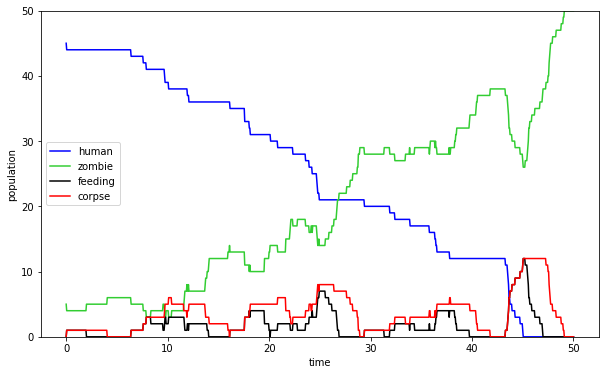

In [22]:
solution.PlotPopulation()

--- 
## Modelling the spread of Covid

<img src="https://raw.githubusercontent.com/drjonshiach/Agent-Based-Modelling/master/Images/covid.png" align=right width=200>

Perhaps a more realistic scenario in which to apply our agent based model is the modelling the spread of the Covid virus. This model is similar to the zombie model in some respects but without the chase and evade behaviours (we will assume that those people infected with Covid will not want to purposely infect other people). 

The Covid virus is like many other viruses such as the common cold where the virus lives within a host. A person infected with the virus may suffer from symptoms such as breathing difficulties and fever which can in rare occasions unfortunately result in the death of the host. After a time the hosts immune system will fight off the virus and the host will recover and become immune from being reinfected by the same virus. During the time when the host is infected with the virus they can infect other people who are close by. 

To help prevent the spread of the Covid virus we can implement the following strategies which we can include in our model:

- **Social distancing**: agents will attempt to remain more than a certain distance from other agents.
- **Quarantining**: after a certain time infected agents will quarantine and will not be able to infect other agents.

Social distancing can be modelled using the [`Separation()`](#Separation) function from the [Boids](#Separation) model and quarantining by ignoring the infection rule for that agent.

We will start with assigning the majority of our agents with the status `susceptible` which means that these represent people who have not had Covid so have a possibility of contracting it along with a small number of `infected` agents. The agents are also given `timer` attribute which will be used to track the time that the agent has been infected. 

In [23]:
class covid(zombie):
    def __init__(self):
        super().__init__()
        self.status = "susceptible"
        self.minspeed = 5
        self.maxspeed = 5
        self.timer = -1
                          
    def AgentList():
        agents = [covid() for _ in range(nagents)]
        for i in range(ninfected):
            agents[i].status = "infected"
            agents[i].colour = "red"
            agents[i].timer = recovery_time
        return agents
    
    class data(agent.data):
        def __init__(self, agentlist):
            super().__init__(agentlist)
        
        def InitialisePopulation(self, agentlist):
            self.agenttypes = ['susceptible', 'infected', 'recovered', 'quarantined', 'deceased']
            self.agentcolours = ['blue', 'red', 'limegreen', 'orange', 'black']
            self.population = np.array([[nagents - ninfected, ninfected, 0, 0, 0]])

### Infection

To model an infected agent infecting a neighbouring susceptible agent we simply check whether the distance to the neighbouring agent is less than some infection radius. We then check whether some random number is less than the probability of infection and if so we say that the susceptible agent has been infected and change its agent type and set the timer to the recovery time.

In [24]:
class covid(covid):
    def Infection(self):
        for neighbour in self.neighbours:
            squared_distance = (self.x - neighbour.x) ** 2 + (self.y - neighbour.y) ** 2
            if squared_distance < infect_radius ** 2 and neighbour.status == "susceptible":
                if np.random.rand() < prob_infect:  
                    neighbour.status = "infected"
                    neighbour.colour = "red"
                    neighbour.timer = recovery_time

### Recovery 

The function `Recovery()` defined below checks whether an infected agent has recovered. We first subtract the time step from the timer so that it counts down to zero. If the timer is less than zero then the recovery time has elapsed and we change the agent type to that of recovered agent. If the model uses quarantining then we also check whether the agent was quarantined and if so it is returned to the model at a random position.

In [25]:
class covid(covid):             
    def Recovery(self):
        self.timer -= time_step
        if self.timer < 0:
            if self.status == "quarantined":
                self.x = width * np.random.rand()
                self.y = height * np.random.rand()
            self.status = "recovered"
            self.colour = "green"
            self.move = True

### Quarantine

The function `Quarantine()` defined below checks whether an infected agent is going into quarantine. We check whether the agent's timer is less than the quarantine time and if so we remove the agent from the model by setting its position outside of the region.

In [26]:
class covid(covid):  
    def Quarantine(self):
        if self.timer < quarantine_time:
            self.x = -100 + np.random.rand()
            self.y = 1
            self.status = "quarantined"
            self.move = False

### Mortality

The function `Mortality()` defined below checks whether and infected agent will die within the time step. This is done by checking whether a random number between 0 and 1 is less than the probability that the agent will die within a single time step. If the agent has died its is removed from the model.

In [27]:
class covid(covid):        
    def Mortality(self):
        if np.random.rand() < prob_death:
            self.x = -100 + np.random.rand()
            self.y = 1
            self.status = "deceased"
            self.timer = -1
            self.move = False

### Applying the agent rules

The function `Rules()` defined below applies the `Infection()`, `Recovery()` and `Mortality` for infected or quarantined agents. If social distancing is turned on then the [`Separation()`](#Separation) rule from the [Boids](#Separation) model is used. If quarantining is turned on then the `Quarantine()` rule is applied. Finally the [`RandomPath`](#Random-path) from the [zombie](#Random-path) model is used so that the agents move in a random path and [`AvoidEdges()`](#Avoid-edges) rule is used to keep the agents within the edges.

In [28]:
class covid(covid):        
    def Rules(self):       
        if self.status == "infected" or self.status == "quarantined":
            self.Infection()
            self.Recovery()
            self.Mortality()
        if distancing:
            self.Separation()
        if quarantining and self.status == "infected":
            self.Quarantine()
        self.RandomPath() 
        self.AvoidEdges()

### Running the model

The code below defines the model parameters and runs the model. Here the social distancing and quarantining have been turned off so the infection should spread quickly. Try experimenting with different parameters to see what affects this has on the model.

In [33]:
# Model parameters
nagents = 100              # number of agents
ninfected = 1              # initial number of infected agents
max_time = 40              # max time for the simulation
infect_radius = 2          # radius which determines whether infection is passed on
detection_radius = 3       # radius for detecting neighbouring agents
separation_radius = 3      # radius for avoiding nearby agents
recovery_time = 10         # time taken to recover after infection
quarantine_time = 5        # time spent in quarantine
separation_factor = 2      # separation steering factor
prob_infect = 0.1          # probability of infection for each time step 
prob_death = 0.0001        # probability of dying in a single time step     
distancing = False         # invoke social distancing (True or False)
quarantining = False       # invoke quarantining (True of False)

# Run simulation
solution = Simulation(covid)

# Generate animation
anim = solution.Animation()
plt.close()
HTML(anim.to_jshtml(fps=20))

IntProgress(value=0, description='Simulation', max=800)

IntProgress(value=0, description='Animation', max=801)

### Social distancing

To see the affect that social distancing has on the spread of the infection the code below runs the simulation with and without social distancing and produces the population plots. 

IntProgress(value=0, description='Simulation', max=800)

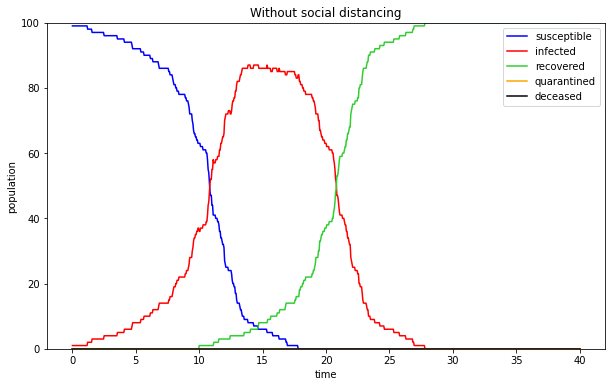

IntProgress(value=0, description='Simulation', max=800)

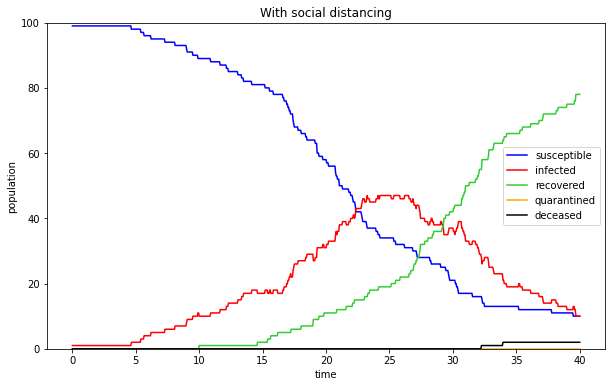

In [30]:
# Run simulation without social distancing
max_time = 40
distancing = False
quarantining = False
solution = Simulation(covid)
solution.PlotPopulation("Without social distancing")

# Run simulation with social distancing
distancing = True
quarantining = False
solution = Simulation(covid)
solution.PlotPopulation("With social distancing")

To see the affects that quarantining has we can produce plots for the model with and without quarantining. What conclusions can you draw from these plots?

IntProgress(value=0, description='Simulation', max=800)

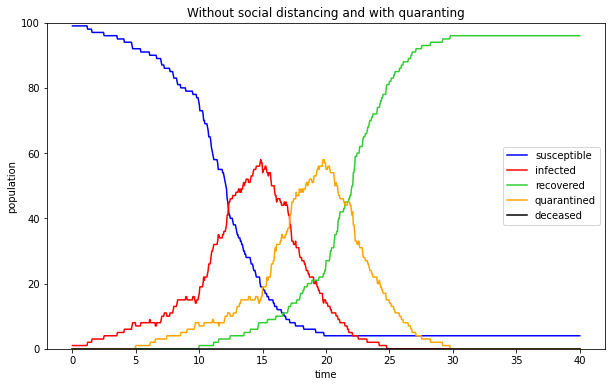

IntProgress(value=0, description='Simulation', max=800)

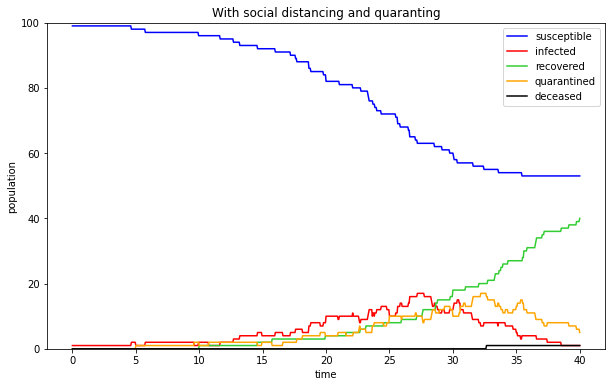

In [31]:
# Run simulation without social distancing and with quarantining
distancing = False
quarantining = True
solution = Simulation(covid)
solution.PlotPopulation("Without social distancing and with quaranting")

# Run simulation with social distancing and quarantining
distancing = True
quarantining = True
solution = Simulation(covid)
solution.PlotPopulation("With social distancing and quaranting")

### Extending the model

The Covid model we have here is quite simplistic and makes the following assumptions about the population.

- Each agent has an equal chance of being infected if in close proximity to an infected agent.
- Each agent has an equal change of dieing from the infection.
- All agents are obedient and will try to avoid other agents when social distancing is turned on.
- All agents will quarantine themselves if they know they are infected.
- Agents are evenly spread and do not cluster around certain areas (e.g., shops, schools etc.).

We could extend our model to take in these additional consideration into account. This is what makes mathematical modelling so useful.

---
## Useful Links

If you would like to further explore Python and fractals you may find the following links useful:

- [Anaconda](https://www.anaconda.com/products/distribution) - a suite of software tools that includes Jupyter Notebook and Python. Download and install on your computer to write and run Jupyter notebooks
- [Google Colab](https://colab.research.google.com/) - run Jupyter notebooks in the cloud using Google Colab (you will need to have a Google account to do this)
- [Agent based modelling](https://en.wikipedia.org/wiki/Agent-based_model)
- [Boids model](https://en.wikipedia.org/wiki/Boids)

&copy; Dr Jon Shiach 2022